In [1]:
%cd '/home/subhamoy/sharps-embeddings/src/'
import torch
import pytorch_lightning as pl
from vae import SharpVAE
from dataset import SHARPdataset
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

/home/subhamoy/sharps-embeddings/src


In [2]:
image_size = 128
idx = 1
DATA_PATH = '/d0/kvandersande/sharps_hdf5/'
dataset = SHARPdataset(DATA_PATH,image_size=image_size)
(image, filename) = dataset[idx]

/home/subhamoy/.conda/envs/sharp-embed/lib/python3.10/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


In [3]:
len(dataset)

49552

In [4]:
image.shape

torch.Size([4, 128, 128])

In [28]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [29]:
device

device(type='cuda', index=0)

In [26]:
def GenImage(image, latent_dim, model, random = False):
    #torch.manual_seed(0)
    if random:
        rand_v = torch.rand((1, latent_dim))
        p = torch.distributions.Normal(torch.zeros_like(rand_v), torch.ones_like(rand_v))
        with torch.no_grad():
            z = p.rsample()
            image_out = model.decoder(z.to(model.device)).cpu()
    else:
        image_ = image[None,:,:,:]
        with torch.no_grad():
            enc = model.encoder(image_)
            latent = model.fc_mu(enc)
            latent_var = model.fc_var(enc)
            std = torch.exp(latent_var / 2)
            q = torch.distributions.Normal(latent, std)
            z = latent #q.rsample()
            image_out = model.decoder(z.to(model.device)).cpu()
    return image_out, z

In [22]:
device

device(type='cuda', index=0)

Text(0.5, 0.98, 'Original')

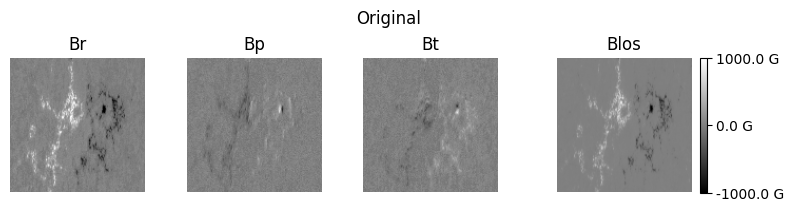

In [20]:
delta = 0.0
fig, axes = plt.subplots(1,4, figsize=(8,2), constrained_layout=True)
ax = axes.ravel()
titles = ['Br', 'Bp', 'Bt', 'Blos']
for i, t in enumerate(titles):
    im = ax[i].imshow(image[i,:,:],
            cmap='gray',
            vmin=delta,
            vmax=1 - delta)
    ax[i].axis('off')
    ax[i].set_title(t)
    
ticks = [delta, 0.5, 1-delta]
tlabels = [f'{np.round(2000*(t-0.5))} G' for t in ticks]
cbar = fig.colorbar(im, ticks=ticks)
cbar.ax.set_yticklabels(tlabels) 
plt.suptitle('Original')

['ldim 20 resnet (β=1)', 'ldim 20 sim (β=1)', 'ldim 20 sim (β=200)', 'ldim 20 resnet (β=80)']


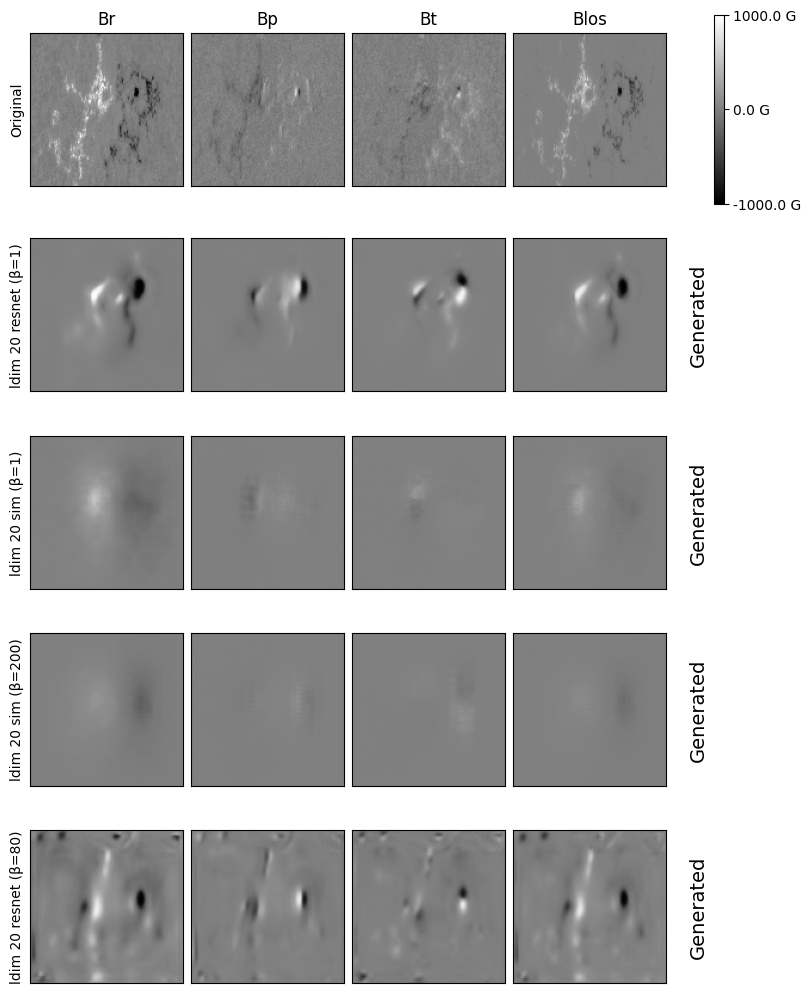

In [30]:
model_dict = {'ldim 20 resnet (\u03B2=1)': 'epoch=98-step=76626.ckpt',
              'ldim 20 sim (\u03B2=1)':'epoch=94-name=0.ckpt',
              'ldim 20 sim (\u03B2=200)':'Subh_stride_1_bs_64_ld_20_backbone_simple_lr_0.0001_crop_False_sharp_constr_False_beta_200.ckpt',
              'ldim 20 resnet (\u03B2=80)':'Subh_stride_1_bs_64_ld_20_backbone_resnet_lr_0.0001_crop_False_sharp_constr_False_beta_80.ckpt'}

# {'ldim 20  low lr': 'epoch=29-step=34200.ckpt',
#               'ldim 100 low lr': 'epoch=99-step=114000.ckpt',
#               'ldim 256 low lr': 'epoch=99-step=114000-v1.ckpt',
#               'ldim 256 high lr': 'epoch=95-step=109440.ckpt',
#               'ldim 256 high lr crop': 'epoch=53-step=40554.ckpt'}

keys = list(model_dict.keys())
print(keys)
fig, axes = plt.subplots(1+len(keys), 4, figsize=(8,2*(1+len(keys))), constrained_layout=True)
ax = axes.ravel()
for i, t in enumerate(titles):
    im = ax[i].imshow(image[i,:,:],
            cmap='gray',
            vmin=delta,
            vmax=1 - delta)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(t)
    ax[0].set_ylabel('Original')
    
ticks = [delta, 0.5, 1-delta]
tlabels = [f'{np.round(2000*(t-0.5))} G' for t in ticks]
cbar = fig.colorbar(im, ticks=ticks)
cbar.ax.set_yticklabels(tlabels) 

image = image.to(device)
for j,k in enumerate(keys):
    model_name = model_dict[k]
    model = SharpVAE.load_from_checkpoint(f'/d0/subhamoy/models/vae/sharps/{model_name}')
    if torch.cuda.is_available(): model.cuda()
    latent_dim = int(k[5:8])
    image_out, _ = GenImage(image, latent_dim, model, random=False)

    titles = ['Br', 'Bp', 'Bt', 'Blos']
    for i, t in enumerate(titles):
        im = ax[i+4*(j+1)].imshow(image_out[0,i,:,:],
                cmap='gray',
                vmin=delta,
                vmax=1 - delta)
        ax[i+4*(j+1)].set_xticks([])
        ax[i+4*(j+1)].set_yticks([])
        #ax[i+4*(j+1)].set_title(t)
        ax[4*(j+1)].set_ylabel(k)
    ax[i+4*(j+1)].set_ylabel('Generated', labelpad=-140, fontsize=14)
    # ax2 = ax[i+4*(j+1)].twinx()
    # ax2.set_ylim([0,127])
    # ax2.set_xticks([])
    # ax2.set_yticks([])
    # ax2.set_ylabel('Generated')
        
    ticks = [delta, 0.5, 1-delta]
    tlabels = [f'{np.round(2000*(t-0.5))} G' for t in ticks]
    #cbar = fig.colorbar(im, ticks=ticks)
    #cbar.ax.set_yticklabels(tlabels) 
#plt.suptitle('Generated')

In [34]:
df = {'filename':[]}
for i in range(20):
    df[f'z_{i}'] = []

In [35]:
df

{'filename': [],
 'z_0': [],
 'z_1': [],
 'z_2': [],
 'z_3': [],
 'z_4': [],
 'z_5': [],
 'z_6': [],
 'z_7': [],
 'z_8': [],
 'z_9': [],
 'z_10': [],
 'z_11': [],
 'z_12': [],
 'z_13': [],
 'z_14': [],
 'z_15': [],
 'z_16': [],
 'z_17': [],
 'z_18': [],
 'z_19': []}

In [41]:
model_name = 'Subh_stride_1_bs_64_ld_20_backbone_simple_lr_0.0001_crop_False_sharp_constr_False_beta_200.ckpt'
for i in range(len(dataset)):
    (image, filename) = dataset[i]
    df['filename'].append(filename)
    image = image.to(device)
    model = SharpVAE.load_from_checkpoint(f'/d0/subhamoy/models/vae/sharps/{model_name}')
    if torch.cuda.is_available(): model.cuda()
    _, z = GenImage(image, latent_dim, model, random=False)
    for k in range(latent_dim):
        df[f'z_{k}'].append(z[0].cpu().numpy()[k])
        
    print(f'{i+1}--done out of--49552')
    
    

/home/subhamoy/.conda/envs/sharp-embed/lib/python3.10/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


1--done out of--49552
2--done out of--49552
3--done out of--49552
4--done out of--49552
5--done out of--49552
6--done out of--49552
7--done out of--49552
8--done out of--49552
9--done out of--49552
10--done out of--49552
11--done out of--49552
12--done out of--49552
13--done out of--49552
14--done out of--49552
15--done out of--49552
16--done out of--49552
17--done out of--49552
18--done out of--49552
19--done out of--49552
20--done out of--49552
21--done out of--49552
22--done out of--49552
23--done out of--49552
24--done out of--49552
25--done out of--49552
26--done out of--49552
27--done out of--49552
28--done out of--49552
29--done out of--49552
30--done out of--49552
31--done out of--49552
32--done out of--49552
33--done out of--49552
34--done out of--49552
35--done out of--49552
36--done out of--49552
37--done out of--49552
38--done out of--49552
39--done out of--49552
40--done out of--49552
41--done out of--49552
42--done out of--49552
43--done out of--49552
44--done out of--495

104--done out of--49552
105--done out of--49552
106--done out of--49552
107--done out of--49552
108--done out of--49552
109--done out of--49552
110--done out of--49552
111--done out of--49552
112--done out of--49552
113--done out of--49552
114--done out of--49552
115--done out of--49552
116--done out of--49552
117--done out of--49552
118--done out of--49552
119--done out of--49552
120--done out of--49552
121--done out of--49552
122--done out of--49552
123--done out of--49552
124--done out of--49552
125--done out of--49552
126--done out of--49552
127--done out of--49552
128--done out of--49552
129--done out of--49552
130--done out of--49552
131--done out of--49552
132--done out of--49552
133--done out of--49552
134--done out of--49552
135--done out of--49552
136--done out of--49552
137--done out of--49552
138--done out of--49552
139--done out of--49552
140--done out of--49552
141--done out of--49552
142--done out of--49552
143--done out of--49552
144--done out of--49552
145--done out of

In [43]:
import pandas as pd
df = pd.DataFrame(df)

In [44]:
df.head(5)

,filename,z_0,z_1,z_2,z_3,z_4,z_5,z_6,z_7,z_8,...,z_10,z_11,z_12,z_13,z_14,z_15,z_16,z_17,z_18,z_19
0,/d0/kvandersande/sharps_hdf5/hmi.sharp_cea_720...,-1.141576,0.998896,1.089222,-1.136359,0.681369,-0.251202,-1.509923,0.020608,-0.565222,...,-0.576036,-0.301420,-0.410184,0.521977,0.884022,-0.474703,-0.096677,0.949219,-0.471916,-0.988534
1,/d0/kvandersande/sharps_hdf5/hmi.sharp_cea_720...,-1.554016,0.727665,1.689094,-1.599778,-0.282644,0.361001,-0.397793,0.291006,-0.904117,...,-0.051495,0.063078,-0.657987,1.043354,1.367143,-0.254040,0.997968,1.239130,0.344554,0.273619
2,/d0/kvandersande/sharps_hdf5/hmi.sharp_cea_720...,-1.399477,0.597626,1.504608,-1.365258,-0.297965,0.296435,-0.343041,0.150214,-0.853721,...,0.001053,0.044622,-0.621803,0.887047,1.141918,-0.227390,0.930183,1.129849,0.358233,0.268281
3,/d0/kvandersande/sharps_hdf5/hmi.sharp_cea_720...,-1.475675,0.813362,1.522806,-1.621589,-0.014769,0.401524,-0.853723,0.271653,-0.962762,...,-0.103739,0.103057,-0.532069,0.969231,1.245886,-0.182816,0.372489,1.049526,0.258516,-0.048732
4,/d0/kvandersande/sharps_hdf5/hmi.sharp_cea_720...,-1.190247,0.468229,1.337922,-1.139268,-0.298963,0.234501,-0.300469,0.118252,-0.800880,...,0.003654,0.092576,-0.494008,0.744492,1.013401,-0.210144,0.878493,1.001672,0.352293,0.229761


In [ ]:
(image*(image>0.5)).sum()

In [5]:
import pandas as pd

In [6]:
df_infer = pd.read_csv('/d0/subhamoy/models/vae/sharps/simple_vae_ldim_20_inference.csv')

In [7]:
df_param = pd.read_csv('/d0/kvandersande/index_sharps.csv')

In [8]:
print(list(df_param.keys()))

['file', 'sample_time', 'br_file', 'blos_file', 'naxis1', 'naxis2', 't_obs', 't_rec', 'origin', 'date', 'telescop', 'instrume', 'usflux', 'meangam', 'meangbt', 'meangbz', 'meangbh', 'meanjzd', 'meanjzh', 'totusjz', 'totusjh', 'meanalp', 'absnjzh', 'savncpp', 'meanpot', 'totpot', 'meanshr', 'shrgt45', 'r_value', 'ctype1', 'ctype2', 'crpix1', 'crpix2', 'crval1', 'crval2', 'cdelt1', 'cdelt2', 'imcrpix1', 'imcrpix2', 'dsun_obs', 'dsun_ref', 'rsun_ref', 'crln_obs', 'crlt_obs', 'car_rot', 'obs_vr', 'obs_vw', 'obs_vn', 'rsun_obs', 'quality', 'harpnum', 'latdtmin', 'londtmin', 'latdtmax', 'londtmax', 'omega_dt', 'size', 'area', 'nacr', 'size_acr', 'area_acr', 'mtot', 'mnet', 'mpos_tot', 'mneg_tot', 'mmean', 'mstdev', 'mskew', 'mkurt', 'lat_min', 'lon_min', 'lat_max', 'lon_max', 'lon_fwt', 'lat_fwt', 'noaa_ar', 'noaa_ars', 'usfluxl', 'meangbl', 'missvals', 'datamin', 'datamax', 'datamedn', 'datamean', 'C_flare_in_3h', 'M_flare_in_3h', 'X_flare_in_3h', 'flare_intensity_in_3h', 'C_flare_in_6h', '

In [18]:
df_param['usflux'][df_param['file']=='/d0/kvandersande/sharps_hdf5/hmi.sharp_cea_720s.1.20100501_074800_TAI.h5'].values[0]

7.08151747e+21

In [19]:
usflux = []
for f in list(df_infer['filename']):
    u = df_param['usflux'][df_param['file']==f].values[0]
    usflux.append(u)
    

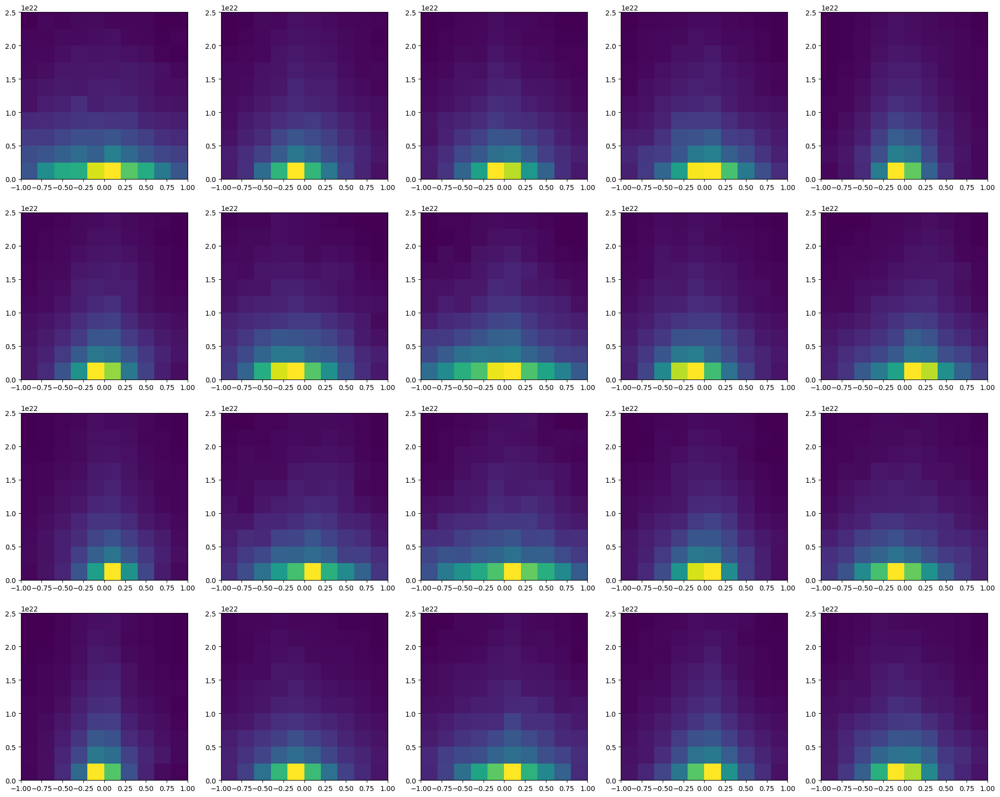

In [35]:
plt.figure(figsize=(25,20))
for i in range(20):
    plt.subplot(4,5,i+1)
    #plt.plot(df_infer[f'z_{i}'].values, usflux, '.')
    plt.hist2d(df_infer[f'z_{i}'].values, usflux, bins=10,range=[[-1,1],[0,0.25*10**23]])
    #plt.yscale('log')
    plt.xlim(-1,1)
    plt.ylim(0,0.25*(10**23))


In [40]:
z[0].cpu().numpy()[0]

-1.4014819

cpu


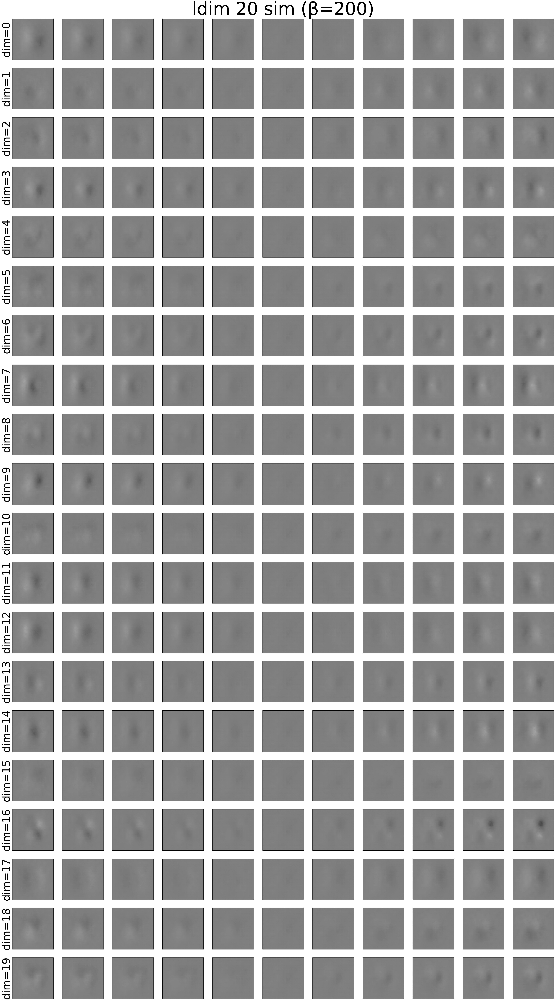

In [11]:
import copy
idx = 10 
delta = 0.15
(image, filename) = dataset[idx]
dim_range = 11
n_dims = 20
fig,axs = plt.subplots(n_dims, dim_range, figsize=(5*dim_range,5*n_dims))
ax = axs.ravel()
key = 'ldim 20 sim (\u03B2=200)'
model_name = model_dict[key]
model = SharpVAE.load_from_checkpoint(f'/d0/subhamoy/models/vae/sharps/{model_name}')
image_out, z1 = GenImage(image, latent_dim, model, random=False)
z1 = z1*0
#dim = 19
#print(z[0][dim])
print(model.device)
for n in range(n_dims):
    z = copy.deepcopy(z1)
    for i in range(dim_range):
        z[0][n] = (i-5)
        with torch.no_grad():
            image_out = model.decoder(z.to(model.device)).cpu()
        k = i + dim_range*n
        ax[k].imshow(image_out[0,0,:,:],
                        cmap='gray',
                        vmin=delta,
                        vmax=1 - delta)
        if i==0: ax[k].set_ylabel(f'dim={n}',fontsize=60)
        if n==0 and i==5: ax[k].set_title(key, fontsize=100) 
        
        ax[k].set_xticks([])
        ax[k].set_yticks([])
    
    

In [64]:
z = torch.zeros(1,latent_dim)
dim_range = 11
plt.figure(figsize=(10*latent_dim,10*dim_range))
for n in range(latent_dim):
    for i in range(dim_range):
        z[0][n] = 2*(i-5)
        with torch.no_grad():
            image_out = model.decoder(z.to(model.device)).cpu()
        plt.subplot(latent_dim,dim_range,1+i+n*dim_range)
        plt.imshow(image_out[0,0,:,:],
                    cmap='gray',
                    vmin=delta,
                    vmax=1 - delta)
        if i==0: plt.ylabel('dim={n}')
        plt.axis('off')

In [21]:
image_size = 128
idx = 100
DATA_PATH = '/d0/kvandersande/sharps_hdf5/'
dataset = SHARPdataset(DATA_PATH,image_size=image_size, crop=False)
(image, filename) = dataset[idx]
print(filename)

/d0/kvandersande/sharps_hdf5/hmi.sharp_cea_720s.12.20100506_074800_TAI.h5


/home/subhamoy/.conda/envs/sharp-embed/lib/python3.10/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


/tmp/ipykernel_1772613/1436964730.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ = df[df['naxis1']>image_size][df['naxis2']>image_size]
/home/subhamoy/.conda/envs/sharp-embed/lib/python3.10/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


['ldim 20']


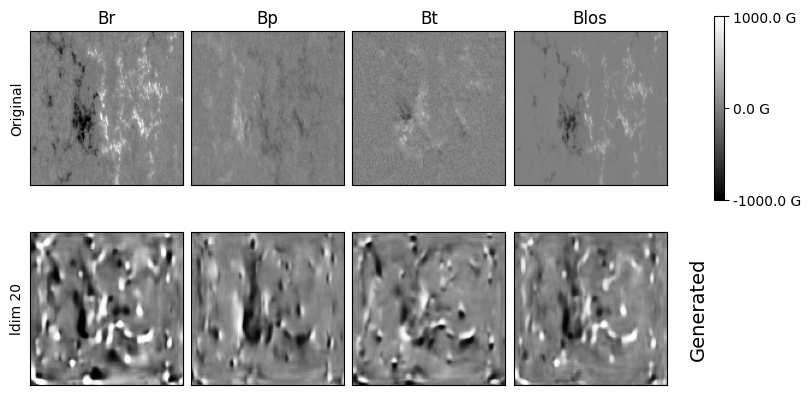

In [22]:
df = pd.read_csv('/d0/kvandersande/index_sharps.csv')
df_ = df[df['naxis1']>image_size][df['naxis2']>image_size]
l = list(df_['file'])
titles = ['Br', 'Bp', 'Bt', 'Blos']
dataset = SHARPdataset(DATA_PATH,image_size=image_size, crop=False)
if filename in l:
    idx_ = l.index(filename)
    (image, filename) = dataset[idx_]
    
    model_dict = {'ldim 20': 'epoch=98-step=76626.ckpt'}
    # model_dict = {'ldim 256 high lr crop': 'epoch=53-step=40554.ckpt',
    #               #'ldim 256 high lr crop sign bal': 'epoch=80-step=60831.ckpt',
    #               'ldim 256 high lr crop flux bal low': 'epoch=70-step=53321-v1.ckpt',
    #               'ldim 256 high lr crop flux bal high': 'epoch=70-step=53321-v2.ckpt'
    #               }

    keys = list(model_dict.keys())
    print(keys)
    fig, axes = plt.subplots(1+len(keys), 4, figsize=(8,2*(1+len(keys))), constrained_layout=True)
    ax = axes.ravel()
    for i, t in enumerate(titles):
        # mask = [image[i,:,:]>0.5]
        # image[i,:,:][mask] = 1
        # mask_n = [image[i,:,:]<0.5]
        # image[i,:,:][mask_n] = 0
        im = ax[i].imshow(image[i,:,:],
                cmap='gray',
                vmin=delta,
                vmax=1 - delta)
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        ax[i].set_title(t)
        ax[0].set_ylabel('Original')
        
    ticks = [delta, 0.5, 1-delta]
    tlabels = [f'{np.round(2000*(t-0.5))} G' for t in ticks]
    cbar = fig.colorbar(im, ticks=ticks)
    cbar.ax.set_yticklabels(tlabels) 

    for j,k in enumerate(keys):
        model_name = model_dict[k]
        model = SharpVAE.load_from_checkpoint(f'/d0/subhamoy/models/vae/sharps/{model_name}')
        latent_dim = int(k[5:8])
        image_out = GenImage(image, latent_dim, model, random=False)

        
        for i, t in enumerate(titles):
            # mask = [image_out[0,i,:,:]>0.5]
            # image_out[0,i,:,:][mask] = 1
            # mask_n = [image_out[0,i,:,:]<0.5]
            # image_out[0,i,:,:][mask_n] = 0
            im = ax[i+4*(j+1)].imshow(image_out[0,i,:,:],
                    cmap='gray',
                    vmin=delta,
                    vmax=1 - delta)
            ax[i+4*(j+1)].set_xticks([])
            ax[i+4*(j+1)].set_yticks([])
            ax[4*(j+1)].set_ylabel(k)
        ax[i+4*(j+1)].set_ylabel('Generated', labelpad=-140, fontsize=14)
            
        ticks = [delta, 0.5, 1-delta]
        tlabels = [f'{np.round(2000*(t-0.5))} G' for t in ticks]
else:
    print('not in list')

In [25]:
dataset = SHARPdataset(DATA_PATH,image_size=image_size, crop=True)
df = {'filename':[],'p_flux_target':[],'n_flux_target':[],
      'p_flux_model':[],'n_flux_model':[],
      'p_flux_model_bal':[],'n_flux_model_bal':[]}
model_unbal = SharpVAE.load_from_checkpoint(f'/d0/subhamoy/models/vae/sharps/epoch=53-step=40554.ckpt')
model_bal = SharpVAE.load_from_checkpoint(f'/d0/subhamoy/models/vae/sharps/epoch=70-step=53321.ckpt')
k = 0
L = len(dataset)
for i in range(L):
      (image, filename) = dataset[i]
      df['filename'].append(filename)
      image_unbal = GenImage(image, 256, model_unbal, random=False)
      image_bal = GenImage(image, 256, model_bal, random=False)
      im_p = (image[0,:,:] - 0.5)*(image[0,:,:]>0.5)
      df['p_flux_target'].append(im_p.sum())
      im_up = (image_unbal[0,0,:,:]-0.5)*(image_unbal[0,0,:,:]>0.5)
      df['p_flux_model'].append(im_up.sum())
      im_bp = (image_bal[0,0,:,:]-0.5)*(image_bal[0,0,:,:]>0.5)
      df['p_flux_model_bal'].append(im_bp.sum())
      im_n = (0.5-image[0,:,:])*(image[0,:,:]<0.5)
      df['n_flux_target'].append(im_n.sum())
      im_un = (0.5-image_unbal[0,0,:,:])*(image_unbal[0,:,:]<0.5)
      df['n_flux_model'].append(im_un.sum())
      im_bn = (0.5-image_bal[0,0,:,:])*(image_bal[0,:,:]<0.5)
      df['n_flux_model_bal'].append(im_bn.sum())
      k += 1
      print(k, f'--out of-- {L}')

/home/subhamoy/sharps-embeddings/src/dataset.py:30: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ = df[df['naxis1']>self.image_size][df['naxis2']>self.image_size]


1 --out of-- 48124
2 --out of-- 48124
3 --out of-- 48124
4 --out of-- 48124
5 --out of-- 48124
6 --out of-- 48124
7 --out of-- 48124
8 --out of-- 48124
9 --out of-- 48124
10 --out of-- 48124
11 --out of-- 48124
12 --out of-- 48124
13 --out of-- 48124
14 --out of-- 48124
15 --out of-- 48124
16 --out of-- 48124
17 --out of-- 48124
18 --out of-- 48124
19 --out of-- 48124
20 --out of-- 48124
21 --out of-- 48124
22 --out of-- 48124
23 --out of-- 48124
24 --out of-- 48124
25 --out of-- 48124
26 --out of-- 48124
27 --out of-- 48124
28 --out of-- 48124
29 --out of-- 48124
30 --out of-- 48124
31 --out of-- 48124
32 --out of-- 48124
33 --out of-- 48124
34 --out of-- 48124
35 --out of-- 48124
36 --out of-- 48124
37 --out of-- 48124
38 --out of-- 48124
39 --out of-- 48124
40 --out of-- 48124
41 --out of-- 48124
42 --out of-- 48124
43 --out of-- 48124
44 --out of-- 48124
45 --out of-- 48124
46 --out of-- 48124
47 --out of-- 48124
48 --out of-- 48124
49 --out of-- 48124
50 --out of-- 48124
51 --out 

KeyboardInterrupt: 

Text(0.5, 1.0, 'balanced positive flux')

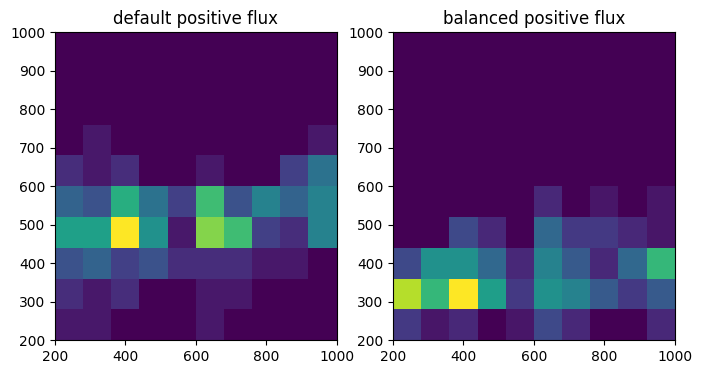

In [32]:
plt.figure(figsize=(8,4))
plt.subplot(1,2,1)
#plt.plot(df['n_flux_target'],df['n_flux_model'],'o',color='r')
plt.hist2d(df['p_flux_target'],df['p_flux_model'],bins=10,range=[[200, 1000], [200, 1000]])
plt.title('default positive flux')
# plt.xlim([2000,6000])
# plt.ylim([2000,6000])
plt.subplot(1,2,2)
plt.hist2d(df['p_flux_target'],df['p_flux_model_bal'],bins=10,range=[[200, 1000], [200, 1000]])
plt.title('balanced positive flux')
#plt.plot(df['n_flux_target'],df['n_flux_model_bal'],'o',color='b')
# plt.xlim([2000,6000])
# plt.ylim([2000,6000])


Text(0.5, 1.0, 'balanced negative flux')

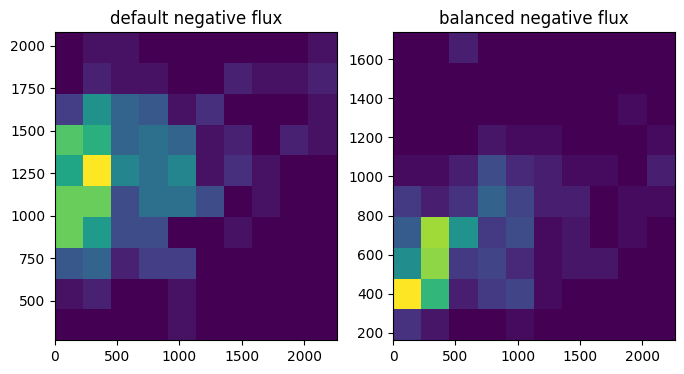

In [28]:
plt.figure(figsize=(8,4))
plt.subplot(1,2,1)
#plt.plot(df['n_flux_target'],df['n_flux_model'],'o',color='r')
plt.hist2d(df['n_flux_target'],df['n_flux_model'],bins=10)
plt.title('default negative flux')
# plt.xlim([2000,6000])
# plt.ylim([2000,6000])
plt.subplot(1,2,2)
plt.hist2d(df['n_flux_target'],df['n_flux_model_bal'],bins=10)
plt.title('balanced negative flux')
#plt.plot(df['n_flux_target'],df['n_flux_model_bal'],'o',color='b')
# plt.xlim([2000,6000])
# plt.ylim([2000,6000])

In [38]:
df = pd.read_csv('/d0/kvandersande/index_sharps.csv')

In [24]:
print(list(df.columns))

['file', 'sample_time', 'br_file', 'blos_file', 'naxis1', 'naxis2', 't_obs', 't_rec', 'origin', 'date', 'telescop', 'instrume', 'usflux', 'meangam', 'meangbt', 'meangbz', 'meangbh', 'meanjzd', 'meanjzh', 'totusjz', 'totusjh', 'meanalp', 'absnjzh', 'savncpp', 'meanpot', 'totpot', 'meanshr', 'shrgt45', 'r_value', 'ctype1', 'ctype2', 'crpix1', 'crpix2', 'crval1', 'crval2', 'cdelt1', 'cdelt2', 'imcrpix1', 'imcrpix2', 'dsun_obs', 'dsun_ref', 'rsun_ref', 'crln_obs', 'crlt_obs', 'car_rot', 'obs_vr', 'obs_vw', 'obs_vn', 'rsun_obs', 'quality', 'harpnum', 'latdtmin', 'londtmin', 'latdtmax', 'londtmax', 'omega_dt', 'size', 'area', 'nacr', 'size_acr', 'area_acr', 'mtot', 'mnet', 'mpos_tot', 'mneg_tot', 'mmean', 'mstdev', 'mskew', 'mkurt', 'lat_min', 'lon_min', 'lat_max', 'lon_max', 'lon_fwt', 'lat_fwt', 'noaa_ar', 'noaa_ars', 'usfluxl', 'meangbl', 'missvals', 'datamin', 'datamax', 'datamedn', 'datamean', 'C_flare_in_3h', 'M_flare_in_3h', 'X_flare_in_3h', 'flare_intensity_in_3h', 'C_flare_in_6h', '

In [39]:
column_names = ['usflux', 'meangam',
                'meangbt', 'meangbz', 
                'meangbh', 'meanjzd', 
                'meanjzh', 'totusjz',
                'totusjh', 'meanalp', 
                'absnjzh', 'savncpp',
                'meanpot', 'totpot', 
                'meanshr', 'shrgt45',
                'r_value', 'size',
                'area', 'nacr',
                'size_acr', 'area_acr',
                'mtot', 'mnet',
                'mpos_tot', 'mneg_tot',
                'mmean', 'mstdev', 'mskew']

In [41]:
df = df[df['naxis1']>128][df['naxis2']>128]

In [42]:
df1 = df.fillna(0)

In [43]:
df2 = (df1[column_names] - df1[column_names].min())/(df1[column_names].max() - df1[column_names].min())

In [47]:
dataset = SHARPdataset(DATA_PATH, image_size=128, crop=True, include_sharp=True)

/home/subhamoy/sharps-embeddings/src/dataset.py:30: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df = df[df['naxis1']>self.image_size][df['naxis2']>self.image_size]


In [48]:
im, p, _ =dataset[1]

In [51]:
im.shape

torch.Size([4, 128, 128])

In [46]:
sum(df2.isnull().values.ravel())

0

In [33]:
df.shape[0] - df.dropna().shape[0]

5478